In [56]:
import glob
import PIL
import numpy as np
import image
import pandas as pd
import os
from itertools import chain
import matplotlib.pyplot as plt
import cv2
import os
from tqdm import tqdm
import cv2
import numpy as np
from tqdm import tqdm
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix

## DATA PROCESSING, DIVISION OF THE IMAGES INTO SEPARATE FOLDERS (YEREVAN/ LONDON), VISUALIZATION OF THE IMAGES, SAVING THE CLEANSED IMAGE NAMES, RESIZING OF THE IMAGES AND NORMALIZATION

In [2]:
for j in range(0,7):
    for i in range(1, 300):
        try:
            img = cv2.imread('/Users/simonyanaleksandr/Desktop/' + format(j) + "/" + format(i) + "_yerevan.jpg", 1)
            path = '/Users/simonyanaleksandr/Desktop/yerevan'
            cv2.imwrite(os.path.join(path , format(i) + "_yerevan.jpg"), img)
            cv2.waitKey(0)
        except:
            pass

In [3]:
for j in range(0,7):
    for i in range(1, 300):
        try:
            img = cv2.imread('/Users/simonyanaleksandr/Desktop/' + format(j) + "/" + format(i) + "_london.jpg", 1)
            path = '/Users/simonyanaleksandr/Desktop/london'
            cv2.imwrite(os.path.join(path , format(i) + "_london.jpg"), img)
            cv2.waitKey(0)
        except:
            pass

In [7]:
files = []
for i in range(1,7):
    files_in_train = sorted(os.listdir("/Users/simonyanaleksandr/Desktop/" +format(i)))
    files.append(files_in_train)

In [8]:
files_in_train = list(chain.from_iterable(files))


In [9]:
files_in_train.remove('.DS_Store')

In [10]:
images=[i for i in files_in_train]
df = pd.DataFrame()
df['images']=[str(x) for x in images]

In [13]:
df['text_new'] = df['images'].str.split('_').str[1]
df['city'] = df['text_new'].str.split('.').str[0]
df[df['text_new'].str.contains("jpg")]
df = df.drop(['text_new'], axis =1)

In [12]:
df = df.drop(['text_new'], axis =1)

In [14]:
df.to_csv("city_name")

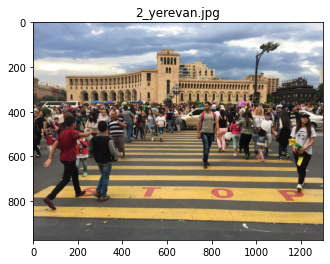

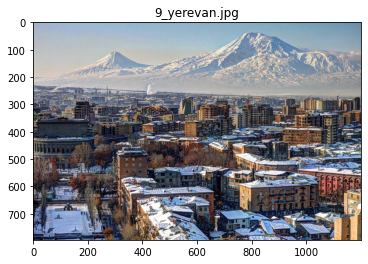

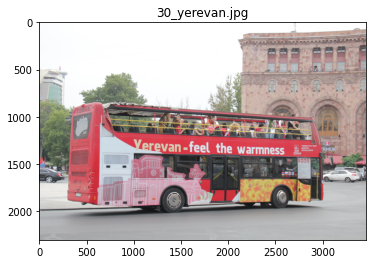

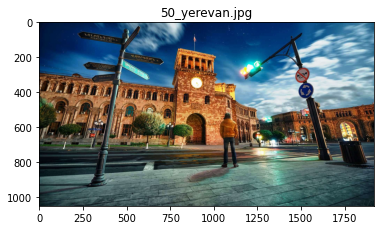

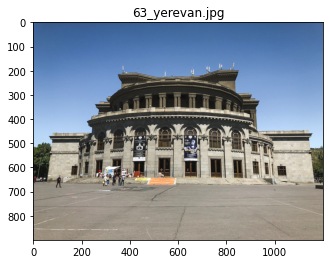

...

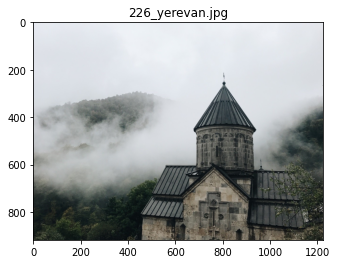

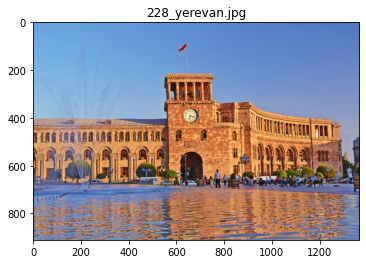

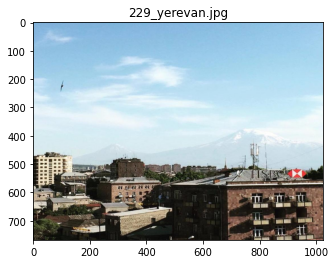

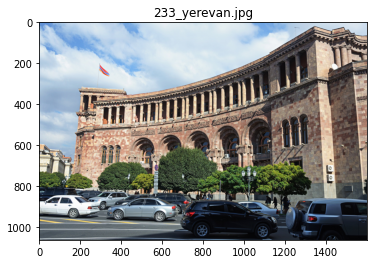

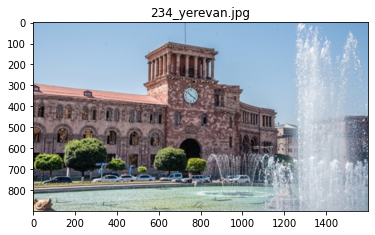

In [15]:
fig, axs = plt.subplots()
for i in range(1, 400):
        try:
            plt.imshow(plt.imread("/Users/simonyanaleksandr/Desktop/yerevan/"+ "/" + format(i) + "_yerevan.jpg"))
            plt.title(format(i) + "_yerevan.jpg")
            plt.show()
        except:
            pass


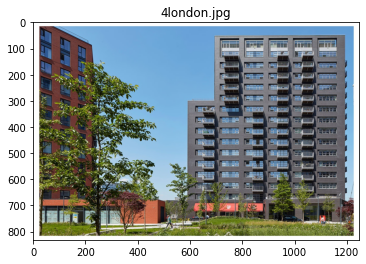

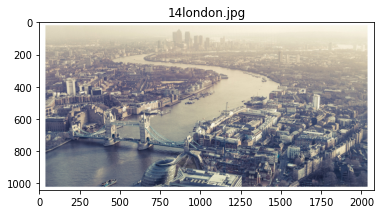

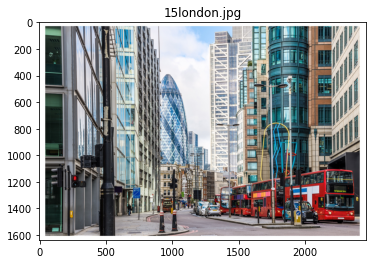

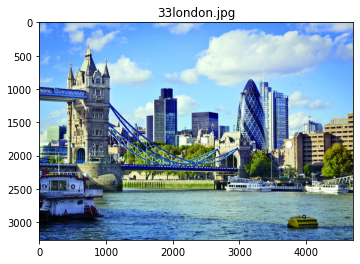

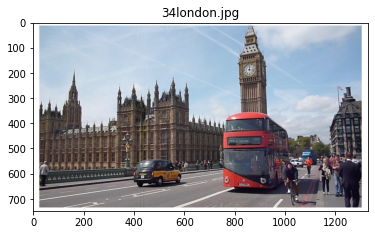

...

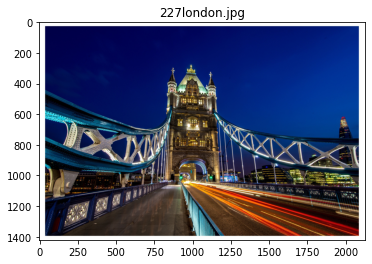

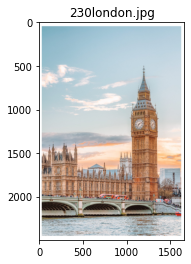

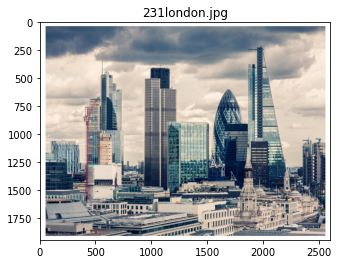

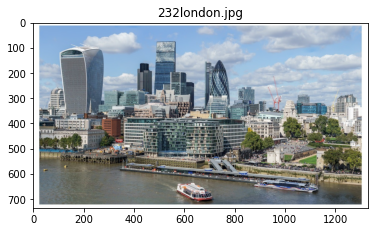

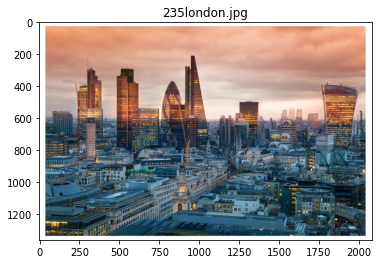

In [16]:
fig, axs = plt.subplots()
for i in range(1, 400):
    try:
        plt.imshow(plt.imread("/Users/simonyanaleksandr/Desktop/london/"+ "/" + format(i) + "_london.jpg"))
        plt.title(format(i) + "london.jpg")
        plt.show()
    except:
        pass

In [17]:
REBUILD_DATA =True 

In [18]:
class londonYerevan():
    IMG_SIZE = 100
    london = '/Users/simonyanaleksandr/Desktop/london'
    yerevan = '/Users/simonyanaleksandr/Desktop/yerevan'
    LABELS = {london: 0, yerevan : 1}
    training_data = []
    londoncount = 0
    yerevancount = 0
    
    def make_training_data(self):
        for label in self.LABELS:
            print(label)
            for f in tqdm(os.listdir(label)):
                if "jpg" in f:
                    try:
                        path = os.path.join(label, f)
                        img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
                        img = cv2.resize(img, (self.IMG_SIZE, self.IMG_SIZE))
                        self.training_data.append([np.array(img), np.eye(2)[self.LABELS[label]]])  \
                     
                        if label == self.london:
                            self.londoncount += 1
                        elif label == self.yerevan:
                            self.yerevancount += 1

                    except Exception as e:
                        pass
                      
        np.random.shuffle(self.training_data)
        np.save("training_data.npy", self.training_data)
        print('yerevan:',yerevanlondon.yerevancount)
        print('london:',yerevanlondon.londoncount)

if REBUILD_DATA:
    yerevanlondon = londonYerevan()
    yerevanlondon.make_training_data()



 19%|█▊        | 14/75 [00:00<00:00, 69.53it/s]

/Users/simonyanaleksandr/Desktop/london


 13%|█▎        | 9/71 [00:00<00:00, 82.11it/s]

/Users/simonyanaleksandr/Desktop/yerevan


100%|██████████| 71/71 [00:01<00:00, 42.68it/s]

yerevan: 70
london: 74


In [19]:
training_data = np.load("training_data.npy", allow_pickle=True)
print(len(training_data))

144


In [20]:
class lYerevan():
    IMG_SIZE = 100
    london = '/Users/simonyanaleksandr/Desktop/test_london'
    yerevan = '/Users/simonyanaleksandr/Desktop/test_yerevan'
    LABELS = {london:0 , yerevan : 1}
    testing_data = []
    londoncount = 0
    yerevancount = 0
    
    def make_testing_data(self):
        for label in self.LABELS:
            print(label)
            for f in tqdm(os.listdir(label)):
                if "jpg" in f:
                    try:
                        path = os.path.join(label, f)
                        img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
                        img = cv2.resize(img, (self.IMG_SIZE, self.IMG_SIZE))
                        self.testing_data.append([np.array(img), np.eye(2)[self.LABELS[label]]])  
                     
                        if label == self.london:
                            self.londoncount += 1
                        elif label == self.yerevan:
                            self.yerevancount += 1

                    except Exception as e:
                        pass
                      
        np.random.shuffle(self.testing_data)
        np.save("testing_data.npy", self.testing_data)
        print('yerevan:',yerevanlondon.yerevancount)
        print('london:',yerevanlondon.londoncount)

if REBUILD_DATA:
    yerevanlondon = lYerevan()
    yerevanlondon.make_testing_data()



 64%|██████▎   | 7/11 [00:00<00:00, 56.88it/s]

/Users/simonyanaleksandr/Desktop/test_london


  0%|          | 0/30 [00:00<?, ?it/s]

/Users/simonyanaleksandr/Desktop/test_yerevan


100%|██████████| 30/30 [00:00<00:00, 39.38it/s]

yerevan: 29
london: 10


In [21]:
testing_data = np.load("testing_dat.npy", allow_pickle=True)
print(len(testing_data))

39


In [30]:
 X= torch.Tensor([i[0] for i in training_data]).view(-1,10000)
train_X = X/255.0
train_y = torch.Tensor([i[1] for i in training_data])

In [31]:
X = torch.Tensor([i[0] for i in testing_data]).view(-1,10000)
test_X = X/255.0
test_y = torch.Tensor([i[1] for i in testing_data])

# IMPLEMENTATION OF THREE LAYER FULLY CONNECTED NEURAL NETWORK

In [28]:
class Net(nn.Module):
    def __init__(self):
        super().__init__()
        self.fc1 = nn.Linear(10000, 240)
        self.fc2 = nn.Linear(240, 240)
        self.fc3 = nn.Linear(240, 2)

    def forward(self, x):
        x = F.relu(self.fc1(x))
        x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return F.log_softmax(x, dim=1)

net = Net()
print(net)

Net(
  (fc1): Linear(in_features=10000, out_features=240, bias=True)
  (fc2): Linear(in_features=240, out_features=240, bias=True)
  (fc3): Linear(in_features=240, out_features=2, bias=True)
)


In [29]:
import torch.optim as optim

loss_function = nn.BCELoss()
optimizer = optim.Adam(net.parameters(), lr=0.001)

In [35]:
tr =  pd.DataFrame([i[1] for i in training_data])

In [37]:
tr = tr[0]

In [38]:
tr = torch.Tensor(tr).long()

In [39]:
te =  pd.DataFrame([i[1] for i in testing_data])

In [40]:
te = te[0]

In [41]:
te = torch.Tensor(te).long()

In [42]:
def train(net):
    for epoch in range(EPOCHS):
        for i in tqdm(range(0, len(train_X), BATCH_SIZE)): 
            
            batch_X = train_X[i:i+BATCH_SIZE].view(-1, 1, 100, 100)
            batch_y = train_y[i:i+BATCH_SIZE]

            net.zero_grad()

            outputs = net(batch_X)
            loss = loss_function(outputs, batch_y)
            loss.backward()
            optimizer.step()    

        print(f"Epoch: {epoch}. Loss: {loss}")

In [43]:
 for epoch in range(15):
        X = train_X
        y = tr
        net.zero_grad() 
        output = net(X.view(-1,10000))  
        loss = F.nll_loss(output, y)  
        loss.backward()  
        optimizer.step() 
        print(loss)  # 

tensor(0.6877, grad_fn=<NllLossBackward>)
tensor(0.6261, grad_fn=<NllLossBackward>)
tensor(3.8659, grad_fn=<NllLossBackward>)
tensor(1.7356, grad_fn=<NllLossBackward>)
tensor(0.8461, grad_fn=<NllLossBackward>)
tensor(1.1269, grad_fn=<NllLossBackward>)
tensor(0.6473, grad_fn=<NllLossBackward>)
tensor(0.7268, grad_fn=<NllLossBackward>)
tensor(0.7313, grad_fn=<NllLossBackward>)
tensor(0.5461, grad_fn=<NllLossBackward>)
tensor(0.5116, grad_fn=<NllLossBackward>)
tensor(0.5120, grad_fn=<NllLossBackward>)
tensor(0.4278, grad_fn=<NllLossBackward>)
tensor(0.4275, grad_fn=<NllLossBackward>)
tensor(0.4050, grad_fn=<NllLossBackward>)


In [44]:
def test(net):
    correct = 0
    total = 0
    with torch.no_grad():
        for i in tqdm(range(len(test_X))):
            real_class = torch.argmax(te[i])
            net_out = net(test_X[i].view(-1, 10000))[0] 
            predicted_class = torch.argmax(net_out)

            if predicted_class == real_class:
                correct += 1
            total += 1

    return("Accuracy: ", correct/total)

In [45]:
test(net)

100%|██████████| 39/39 [00:00<00:00, 1463.25it/s]


('Accuracy: ', 0.717948717948718)

# IMPLEMENTATION OF CONVOLUTIONAL NEURAL NETWORK

In [46]:
class Net(nn.Module):
    def __init__(self):
        super().__init__() 
        self.conv1 = nn.Conv2d(1, 32, 5) 
        self.conv2 = nn.Conv2d(32, 64, 5) 

        x = torch.randn(100,100).view(-1,1,100,100)
        self._to_linear = None
        self.convs(x)

        self.fc1 = nn.Linear(self._to_linear, 512)
        self.fc2 = nn.Linear(512, 2) 

    def convs(self, x):
        # max pooling over 2x2
        x = F.max_pool2d(F.relu(self.conv1(x)), (2, 2))
        x = F.max_pool2d(F.relu(self.conv2(x)), (2, 2))

        if self._to_linear is None:
            self._to_linear = x[0].shape[0]*x[0].shape[1]*x[0].shape[2]
        return x

    def forward(self, x):
        x = self.convs(x)
        x = x.view(-1, self._to_linear) 
        x = F.relu(self.fc1(x))
        x = self.fc2(x) 
        return F.softmax(x, dim=1)

In [47]:
net = Net()
training_data = np.load("training_data.npy", allow_pickle=True)
print(len(training_data))

optimizer = optim.Adam(net.parameters(), lr=0.0005)
loss_function = nn.BCELoss()

X = torch.Tensor([i[0] for i in training_data]).view(-1,100,100)
train_X = X/255.0
train_y = torch.Tensor([i[1] for i in training_data])




144


In [48]:
BATCH_SIZE = 10

In [49]:
testing_data = np.load("testing_dat.npy", allow_pickle=True)
print(len(testing_data))
X = torch.Tensor([i[0] for i in testing_data]).view(-1,100,100)
test_X = X/255.0
test_y = torch.Tensor([i[1] for i in testing_data])

39


In [50]:
EPOCHS = 10

In [51]:
def train(net):
    for epoch in range(EPOCHS):
        for i in tqdm(range(0, len(train_X), BATCH_SIZE)): 
            #print(f"{i}:{i+BATCH_SIZE}")
            batch_X = train_X[i:i+BATCH_SIZE].view(-1, 1, 100, 100)
            batch_y = train_y[i:i+BATCH_SIZE]

            net.zero_grad()

            outputs = net(batch_X)
            loss = loss_function(outputs, batch_y)
            loss.backward()
            optimizer.step()    # Does the update

        print(f"Epoch: {epoch}. Loss: {loss}")

In [52]:
def test(net):
    correct = 0
    total = 0
    with torch.no_grad():
        for i in tqdm(range(len(test_X))):
            real_class = torch.argmax(test_y[i])
            net_out = net(test_X[i].view(-1, 1, 100, 100))[0] 
            predicted_class = torch.argmax(net_out)

            if predicted_class == real_class:
                correct += 1
            total += 1

    return("Accuracy: ", correct/total)
    

In [53]:
train(net)

  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 0. Loss: 0.6902828216552734


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 1. Loss: 0.5950736999511719


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 2. Loss: 0.43950361013412476


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 3. Loss: 0.5554808378219604


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 4. Loss: 0.154867485165596


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 5. Loss: 0.05776246637105942


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 6. Loss: 0.04215727001428604


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 7. Loss: 0.05042494460940361


  0%|          | 0/15 [00:00<?, ?it/s]

Epoch: 8. Loss: 0.01549803838133812


100%|██████████| 15/15 [00:03<00:00,  4.34it/s]

Epoch: 9. Loss: 0.007209895644336939


In [54]:
test(net)

100%|██████████| 39/39 [00:00<00:00, 136.02it/s]


('Accuracy: ', 0.9743589743589743)

 ## IMPLEMENTATION OF  LOGISTIC REGRESSION

In [55]:
X = torch.Tensor([i[0] for i in testing_data]).view(-1,10000)
test_X = X/255.0
test_y = torch.Tensor([i[1] for i in testing_data])

In [57]:
 X= torch.Tensor([i[0] for i in training_data]).view(-1,10000)
train_X = X/255.0
train_y = torch.Tensor([i[1] for i in training_data])

In [58]:
 training =[i[1] for i in training_data]

In [59]:
training=  pd.DataFrame(training)


In [60]:
training = training[0]

In [62]:
 testing=[i[1] for i in testing_data]

In [63]:
testing =  pd.DataFrame(testing)


In [64]:
testing = testing[0]

In [65]:
logreg_classifier = LogisticRegression(solver = 'lbfgs')


In [66]:
logreg_classifier.fit(train_X, training)

/Users/simonyanaleksandr/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_logistic.py:940: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  extra_warning_msg=_LOGISTIC_SOLVER_CONVERGENCE_MSG)


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=100,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [67]:
logreg_pred = logreg_classifier.predict(test_X)

In [68]:
print(classification_report(logreg_pred, testing))
print(confusion_matrix(logreg_pred,testing))

              precision    recall  f1-score   support

         0.0       0.97      1.00      0.98        28
         1.0       1.00      0.91      0.95        11

    accuracy                           0.97        39
   macro avg       0.98      0.95      0.97        39
weighted avg       0.98      0.97      0.97        39

[[28  0]
 [ 1 10]]
